In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [39]:
data = pd.read_csv("heart_attack_prediction_dataset.csv")
selected_columns = ['Age', 'Sex', 'Cholesterol', 'Blood Pressure', 'Diabetes', 'Smoking', 'Obesity',
                    'Exercise Hours Per Week', 'Diet', 'Previous Heart Problems', 'Medication Use',
                    'Stress Level', 'BMI', 'Physical Activity Days Per Week', 'Heart Attack Risk']

#data = data[selected_columns]
data

,Patient ID,Age,Sex,Cholesterol,Blood Pressure,Heart Rate,Diabetes,Family History,Smoking,Obesity,...,Sedentary Hours Per Day,Income,BMI,Triglycerides,Physical Activity Days Per Week,Sleep Hours Per Day,Country,Continent,Hemisphere,Heart Attack Risk
0,BMW7812,67,Male,208,158/88,72,0,0,1,0,...,6.615001,261404,31.251233,286,0,6,Argentina,South America,Southern Hemisphere,0
1,CZE1114,21,Male,389,165/93,98,1,1,1,1,...,4.963459,285768,27.194973,235,1,7,Canada,North America,Northern Hemisphere,0
2,BNI9906,21,Female,324,174/99,72,1,0,0,0,...,9.463426,235282,28.176571,587,4,4,France,Europe,Northern Hemisphere,0
3,JLN3497,84,Male,383,163/100,73,1,1,1,0,...,7.648981,125640,36.464704,378,3,4,Canada,North America,Northern Hemisphere,0
4,GFO8847,66,Male,318,91/88,93,1,1,1,1,...,1.514821,160555,21.809144,231,1,5,Thailand,Asia,Northern Hemisphere,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8758,MSV9918,60,Male,121,94/76,61,1,1,1,0,...,10.806373,235420,19.655895,67,7,7,Thailand,Asia,Northern Hemisphere,0
8759,QSV6764,28,Female,120,157/102,73,1,0,0,1,...,3.833038,217881,23.993866,617,4,9,Canada,North America,Northern Hemisphere,0
8760,XKA5925,47,Male,250,161/75,105,0,1,1,1,...,2.375214,36998,35.406146,527,4,4,Brazil,South America,Southern Hemisphere,1
8761,EPE6801,36,Male,178,119/67,60,1,0,1,0,...,0.029104,209943,27.294020,114,2,8,Brazil,South America,Southern Hemisphere,0


In [40]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8763 entries, 0 to 8762
Data columns (total 26 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   Patient ID                       8763 non-null   object 
 1   Age                              8763 non-null   int64  
 2   Sex                              8763 non-null   object 
 3   Cholesterol                      8763 non-null   int64  
 4   Blood Pressure                   8763 non-null   object 
 5   Heart Rate                       8763 non-null   int64  
 6   Diabetes                         8763 non-null   int64  
 7   Family History                   8763 non-null   int64  
 8   Smoking                          8763 non-null   int64  
 9   Obesity                          8763 non-null   int64  
 10  Alcohol Consumption              8763 non-null   int64  
 11  Exercise Hours Per Week          8763 non-null   float64
 12  Diet                

In [ ]:
# our goal is to predict the Heart Attack Risk based on other features 

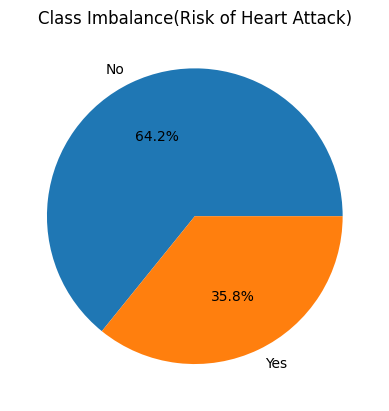

In [41]:
labels = ["No", "Yes"]
values = data["Heart Attack Risk"].value_counts().to_numpy()
plt.pie(values, labels=labels, autopct="%1.1f%%")
plt.title("Class Imbalance(Risk of Heart Attack)")
plt.show()

In [42]:
# prepocessing 
# check missing values
data.isna().sum()

Patient ID                         0
Age                                0
Sex                                0
Cholesterol                        0
Blood Pressure                     0
Heart Rate                         0
Diabetes                           0
Family History                     0
Smoking                            0
Obesity                            0
Alcohol Consumption                0
Exercise Hours Per Week            0
Diet                               0
Previous Heart Problems            0
Medication Use                     0
Stress Level                       0
Sedentary Hours Per Day            0
Income                             0
BMI                                0
Triglycerides                      0
Physical Activity Days Per Week    0
Sleep Hours Per Day                0
Country                            0
Continent                          0
Hemisphere                         0
Heart Attack Risk                  0
dtype: int64

In [43]:
data.dtypes

Patient ID                          object
Age                                  int64
Sex                                 object
Cholesterol                          int64
Blood Pressure                      object
Heart Rate                           int64
Diabetes                             int64
Family History                       int64
Smoking                              int64
Obesity                              int64
Alcohol Consumption                  int64
Exercise Hours Per Week            float64
Diet                                object
Previous Heart Problems              int64
Medication Use                       int64
Stress Level                         int64
Sedentary Hours Per Day            float64
Income                               int64
BMI                                float64
Triglycerides                        int64
Physical Activity Days Per Week      int64
Sleep Hours Per Day                  int64
Country                             object
Continent  

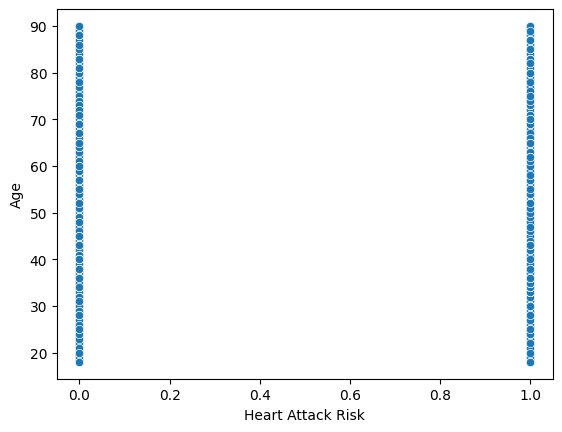

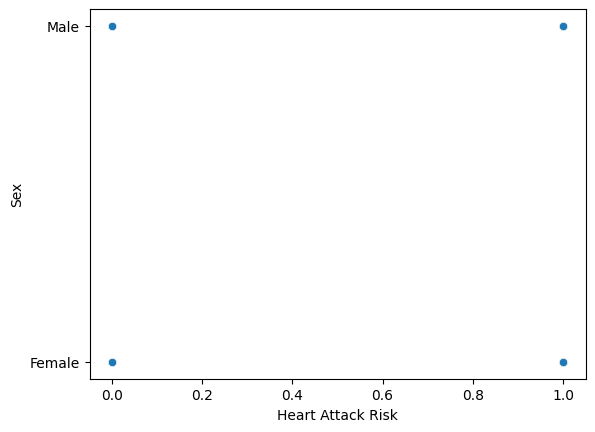

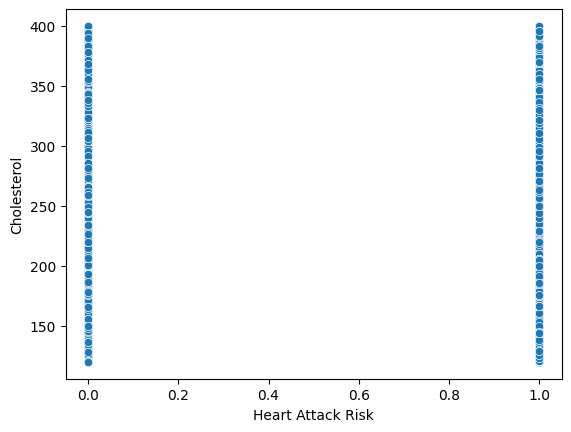

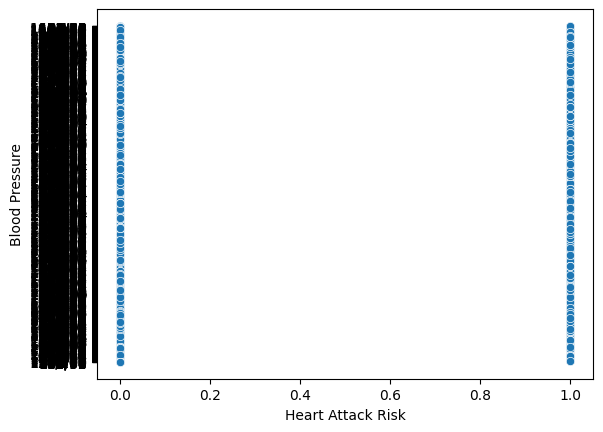

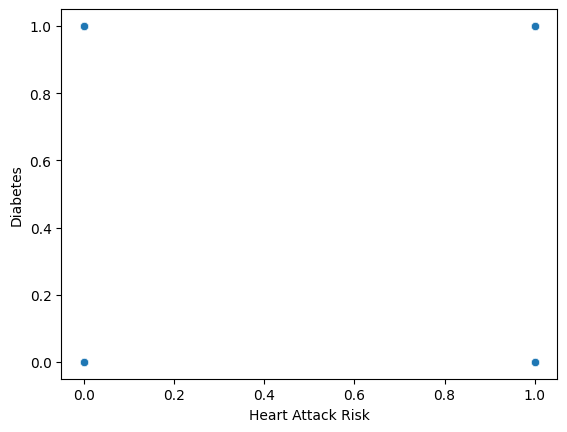

...

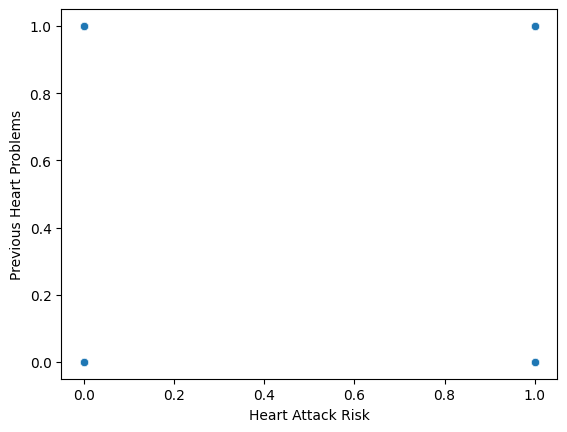

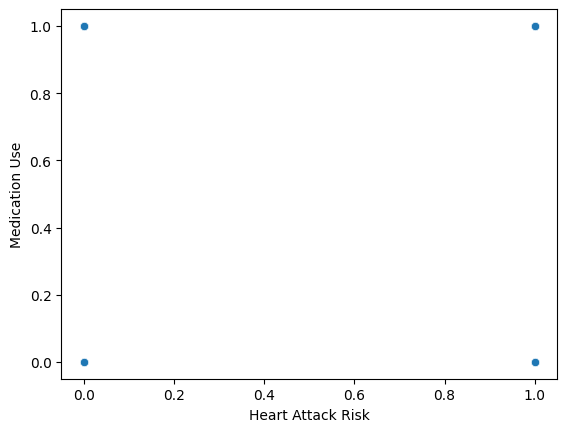

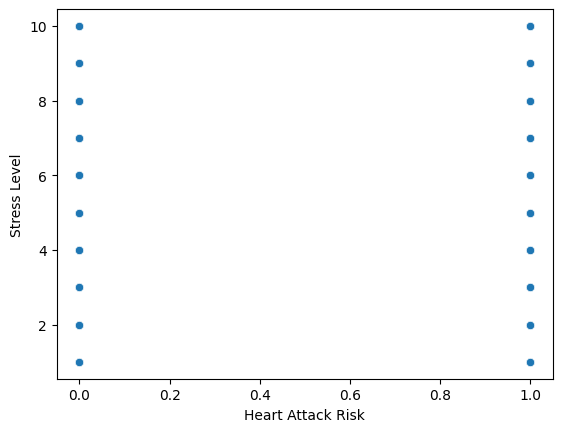

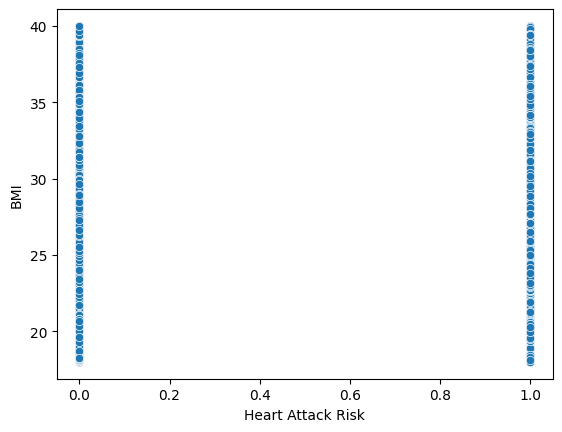

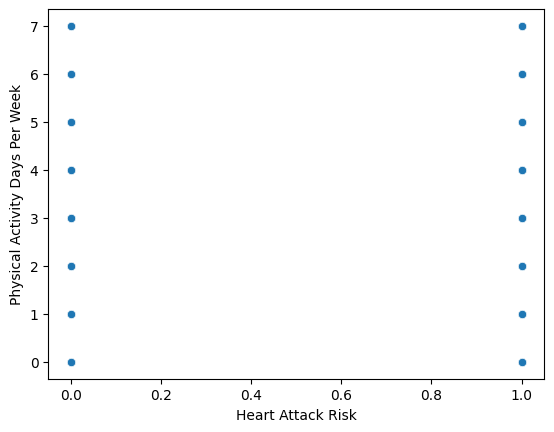

In [15]:
for i in data.columns:
    if( i != "Heart Attack Risk" ):
        sns.scatterplot(x="Heart Attack Risk" , y=i , data=data)
        plt.xlabel('Heart Attack Risk')
        plt.ylabel(i)
        plt.show()

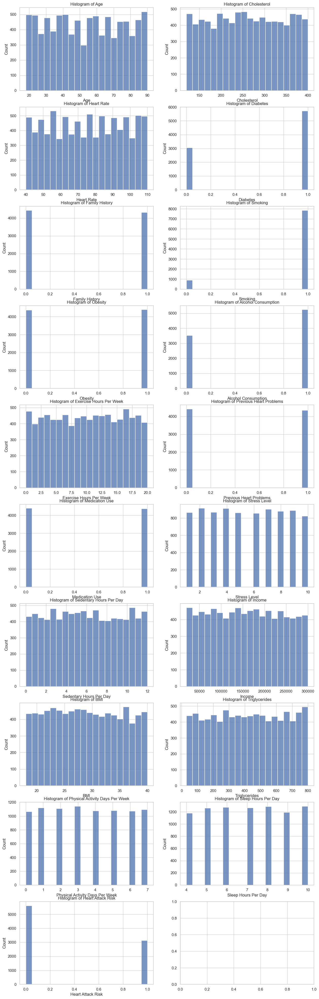

In [45]:
# show numerical col 
numeric_columns = data.select_dtypes(include=['number']).columns
num_plots = len(numeric_columns)
num_cols = 2  # Set the number of columns in the grid
num_rows = (num_plots // num_cols) + (num_plots % num_cols > 0)   # Calculate the number of rows needed
fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 5*num_rows))

for i, col in enumerate(numeric_columns):
    row_idx = i // num_cols
    col_idx = i % num_cols

    sns.histplot(data[col], bins=20, ax=axes[row_idx, col_idx])
    axes[row_idx, col_idx].set_title(f'Histogram of {col}')


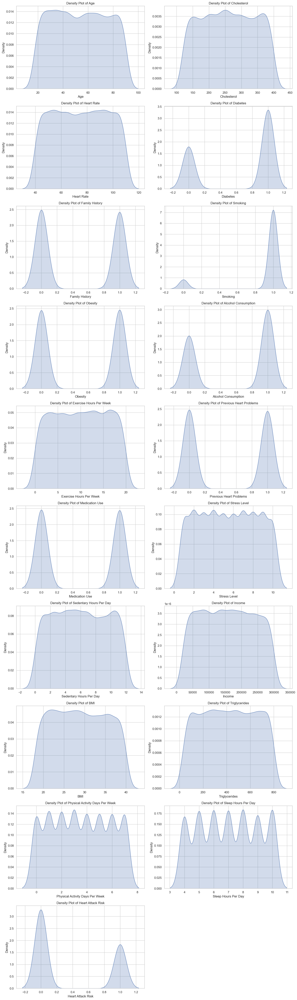

In [49]:
# denisty
# Density Plot
num_cols_density = 2  # Set the number of columns for the density plot
num_rows_density = (len(numeric_columns) // num_cols_density) + (len(numeric_columns) % num_cols_density > 0)

fig_density, axes_density = plt.subplots(num_rows_density, num_cols_density, figsize=(15, 5*num_rows_density))

for i, col in enumerate(numeric_columns):
    row_idx = i // num_cols_density
    col_idx = i % num_cols_density

    sns.kdeplot(data[col], fill=True, ax=axes_density[row_idx, col_idx])
    axes_density[row_idx, col_idx].set_title(f'Density Plot of {col}')

# Remove empty subplots
for i in range(len(numeric_columns), num_rows_density * num_cols_density):
    fig_density.delaxes(axes_density.flatten()[i])

plt.tight_layout()
plt.show()

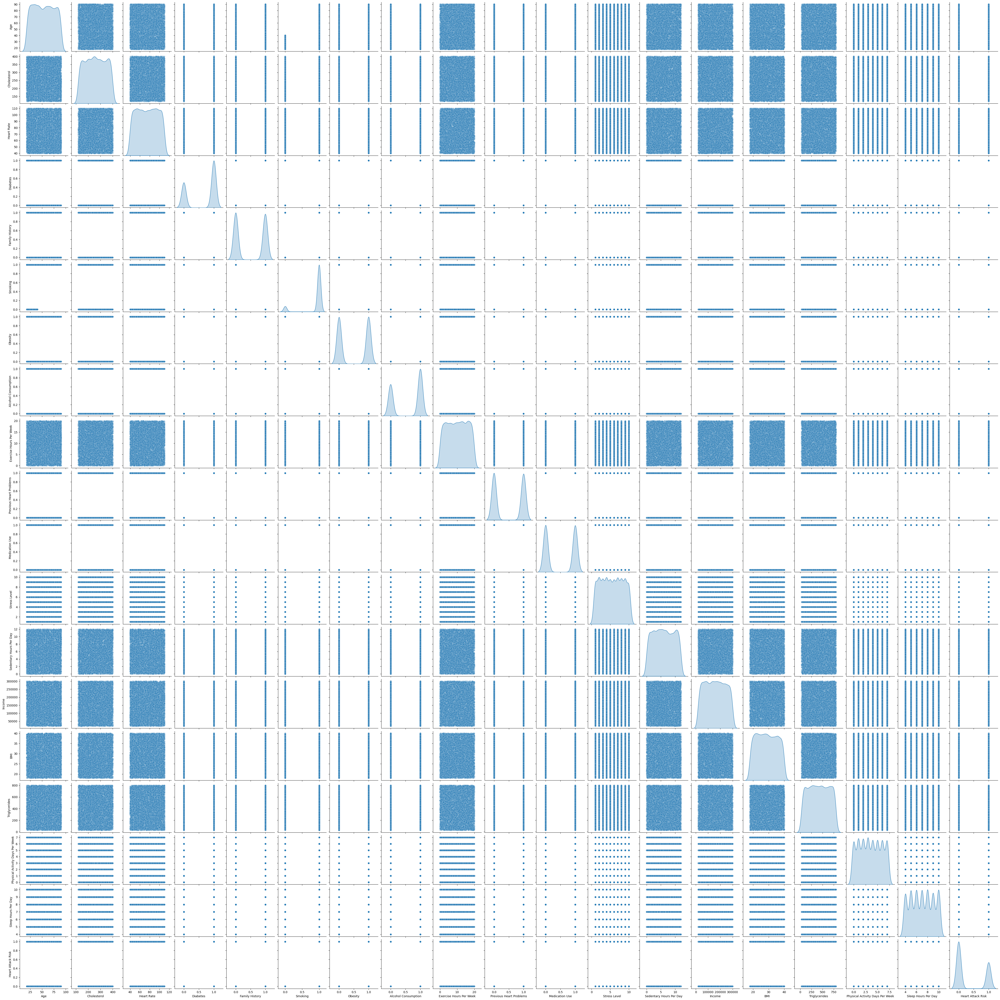

In [4]:
sns.pairplot(data, diag_kind='kde', plot_kws={'alpha': 0.2})

In [44]:
# preprocessing 
# check missing values 
data.isnull().sum()

Patient ID                         0
Age                                0
Sex                                0
Cholesterol                        0
Blood Pressure                     0
Heart Rate                         0
Diabetes                           0
Family History                     0
Smoking                            0
Obesity                            0
Alcohol Consumption                0
Exercise Hours Per Week            0
Diet                               0
Previous Heart Problems            0
Medication Use                     0
Stress Level                       0
Sedentary Hours Per Day            0
Income                             0
BMI                                0
Triglycerides                      0
Physical Activity Days Per Week    0
Sleep Hours Per Day                0
Country                            0
Continent                          0
Hemisphere                         0
Heart Attack Risk                  0
dtype: int64

In [45]:
# split Blood Pressure into BP_Systolic . BP_Diastolic
data[['BP_Systolic' , 'BP_Diastolic']] = data['Blood Pressure'].str.split('/' , expand=True)
data = data.drop("Blood Pressure" , axis=1)

In [46]:
# encoding object values  ( changing categorical values into numerical )
from sklearn.preprocessing import LabelEncoder
encoder = LabelEncoder()
for i in data.columns:
    if(data[i].dtype == "object"):
        data[i] = encoder.fit_transform(data[i])

In [41]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8763 entries, 0 to 8762
Data columns (total 27 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   Patient ID                       8763 non-null   int32  
 1   Age                              8763 non-null   int64  
 2   Sex                              8763 non-null   int32  
 3   Cholesterol                      8763 non-null   int64  
 4   Heart Rate                       8763 non-null   int64  
 5   Diabetes                         8763 non-null   int64  
 6   Family History                   8763 non-null   int64  
 7   Smoking                          8763 non-null   int64  
 8   Obesity                          8763 non-null   int64  
 9   Alcohol Consumption              8763 non-null   int64  
 10  Exercise Hours Per Week          8763 non-null   float64
 11  Diet                             8763 non-null   int32  
 12  Previous Heart Probl

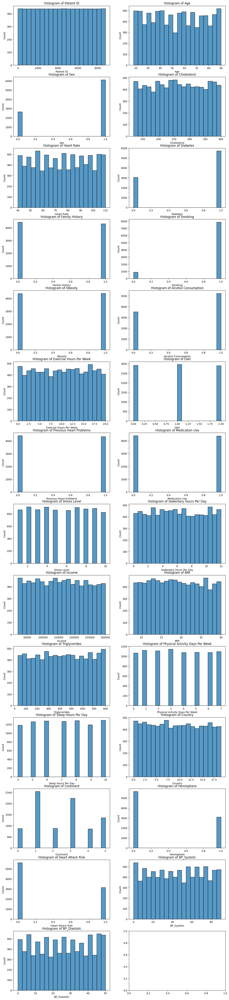

In [17]:
# show numerical col 
numeric_columns = data.select_dtypes(include=['number']).columns
num_plots = len(numeric_columns)
num_cols = 2  # Set the number of columns in the grid
num_rows = (num_plots // num_cols) + (num_plots % num_cols > 0)   # Calculate the number of rows needed
fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 5*num_rows))

for i, col in enumerate(numeric_columns):
    row_idx = i // num_cols
    col_idx = i % num_cols

    sns.histplot(data[col], bins=20, ax=axes[row_idx, col_idx])
    axes[row_idx, col_idx].set_title(f'Histogram of {col}')


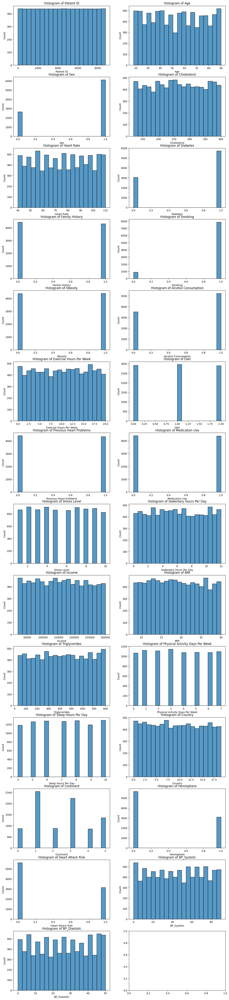

In [18]:
# show numerical col 
numeric_columns = data.select_dtypes(include=['number']).columns
num_plots = len(numeric_columns)
num_cols = 2  # Set the number of columns in the grid
num_rows = (num_plots // num_cols) + (num_plots % num_cols > 0)   # Calculate the number of rows needed
fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 5*num_rows))

for i, col in enumerate(numeric_columns):
    row_idx = i // num_cols
    col_idx = i % num_cols

    sns.histplot(data[col], bins=20, ax=axes[row_idx, col_idx])
    axes[row_idx, col_idx].set_title(f'Histogram of {col}')

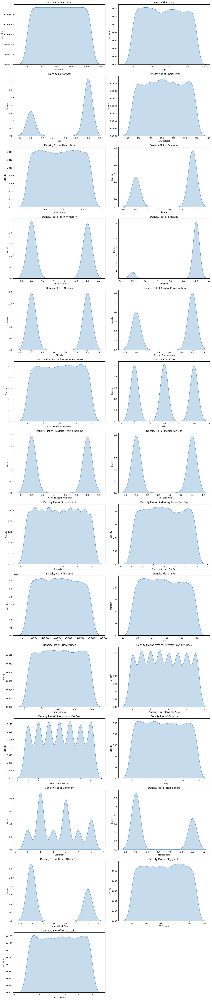

In [19]:
# denisty
# Density Plot
num_cols_density = 2  # Set the number of columns for the density plot
num_rows_density = (len(numeric_columns) // num_cols_density) + (len(numeric_columns) % num_cols_density > 0)

fig_density, axes_density = plt.subplots(num_rows_density, num_cols_density, figsize=(15, 5*num_rows_density))

for i, col in enumerate(numeric_columns):
    row_idx = i // num_cols_density
    col_idx = i % num_cols_density

    sns.kdeplot(data[col], fill=True, ax=axes_density[row_idx, col_idx])
    axes_density[row_idx, col_idx].set_title(f'Density Plot of {col}')

# Remove empty subplots
for i in range(len(numeric_columns), num_rows_density * num_cols_density):
    fig_density.delaxes(axes_density.flatten()[i])

plt.tight_layout()
plt.show()

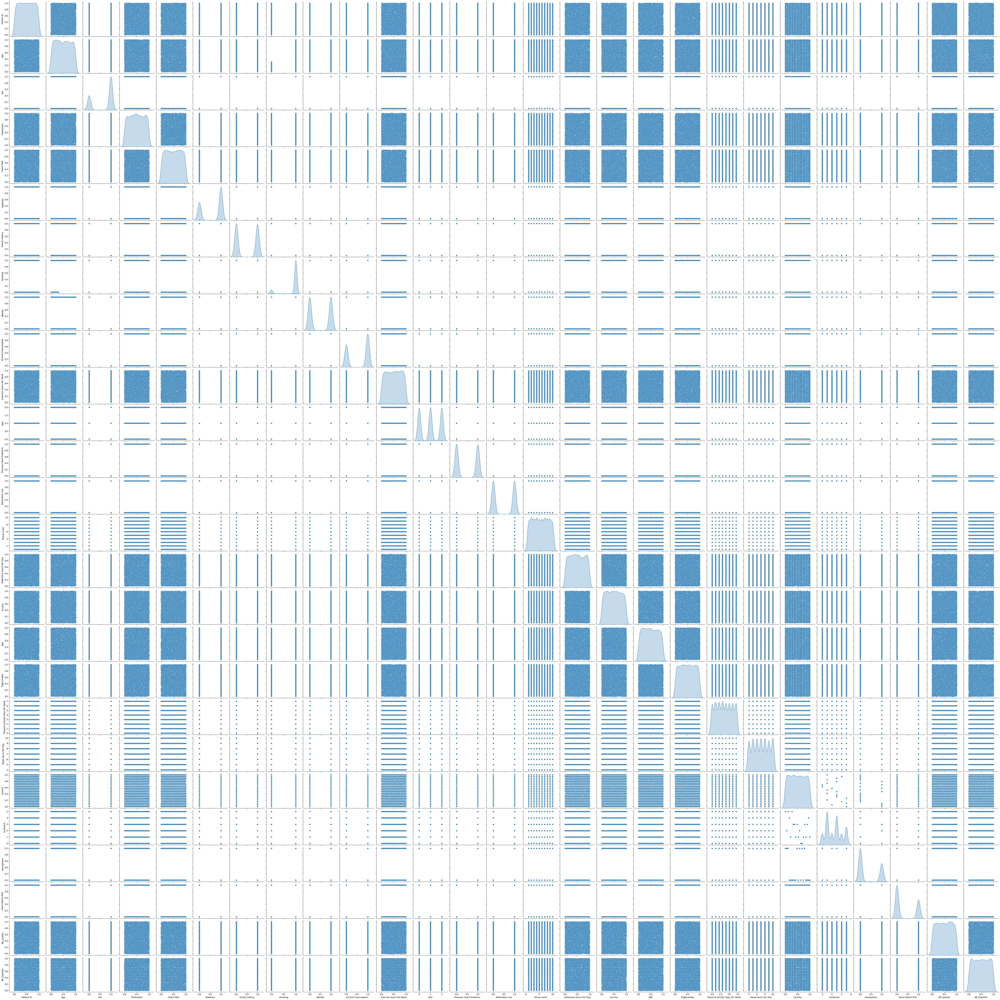

In [61]:
sns.pairplot(data, diag_kind='kde', plot_kws={'alpha': 0.2})

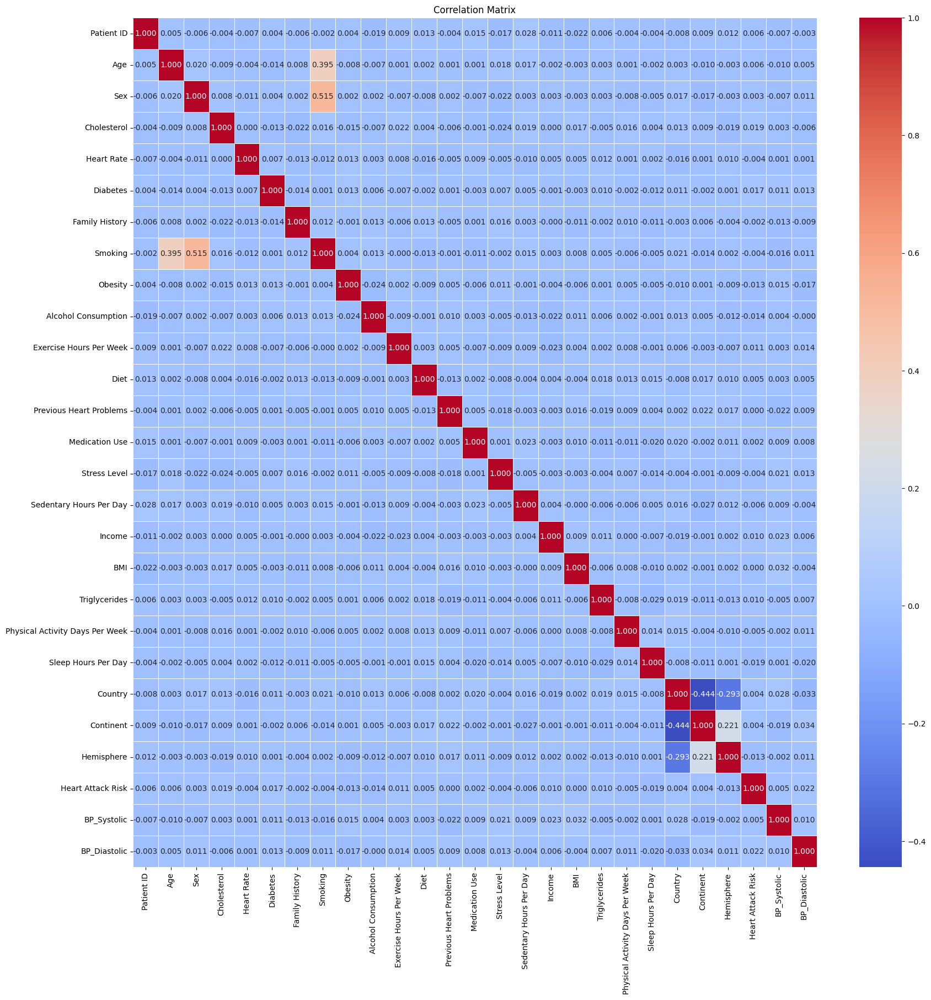

In [47]:
# finding realation between variables 
corr = data.corr()
#Correlation Heatmap

plt.figure(figsize=(20, 20))
sns.heatmap(corr, annot=True, cmap="coolwarm", fmt=".3f", linewidths=0.5)
plt.title("Correlation Matrix")
plt.show()

In [50]:
# filtering data based on corr
threshold = 0.003
print(corr.columns)
print(len(corr.columns))
# Find features with high correlation
highly_correlated_features = set()
for i in corr.columns:
        if (corr.loc["Heart Attack Risk" , i] < threshold):
            colname = i
            highly_correlated_features.add(colname)
data = data.drop(columns=highly_correlated_features)
# Print the remaining features
print("Remaining Features:")
print(len(data_filtered.columns))

Index(['Patient ID', 'Age', 'Sex', 'Cholesterol', 'Heart Rate', 'Diabetes',
       'Family History', 'Smoking', 'Obesity', 'Alcohol Consumption',
       'Exercise Hours Per Week', 'Diet', 'Previous Heart Problems',
       'Medication Use', 'Stress Level', 'Sedentary Hours Per Day', 'Income',
       'BMI', 'Triglycerides', 'Physical Activity Days Per Week',
       'Sleep Hours Per Day', 'Country', 'Continent', 'Hemisphere',
       'Heart Attack Risk', 'BP_Systolic', 'BP_Diastolic'],
      dtype='object')
27
Remaining Features:
12


In [75]:
print("After " , data.columns)

After  Index(['Patient ID', 'Age', 'Sex', 'Cholesterol', 'Diabetes',
       'Exercise Hours Per Week', 'Diet', 'Income', 'Triglycerides', 'Country',
       'Continent', 'Heart Attack Risk', 'BP_Systolic', 'BP_Diastolic'],
      dtype='object')


In [76]:
# spliting data 
X = data.drop("Heart Attack Risk",axis = 1) 
y = data["Heart Attack Risk"] # target 

In [77]:
from sklearn.model_selection import train_test_split

In [78]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.30, random_state=42)

In [57]:
from sklearn.tree import DecisionTreeClassifier , export_graphviz , plot_tree
from sklearn.metrics import confusion_matrix, accuracy_score, precision_score, recall_score, f1_score
from six import StringIO
from IPython.display import Image
import pydotplus
from sklearn.metrics import mean_squared_error

In [79]:
# DecisionTree
dtree = DecisionTreeClassifier(criterion='entropy') # gini or entropy
dtree.fit(X_train, y_train)
pred = dtree.predict(X_test)
before_scaling = accuracy_score(y_test, pred)
print("Accuracy: ", before_scaling)

Accuracy:  0.5302396348421453


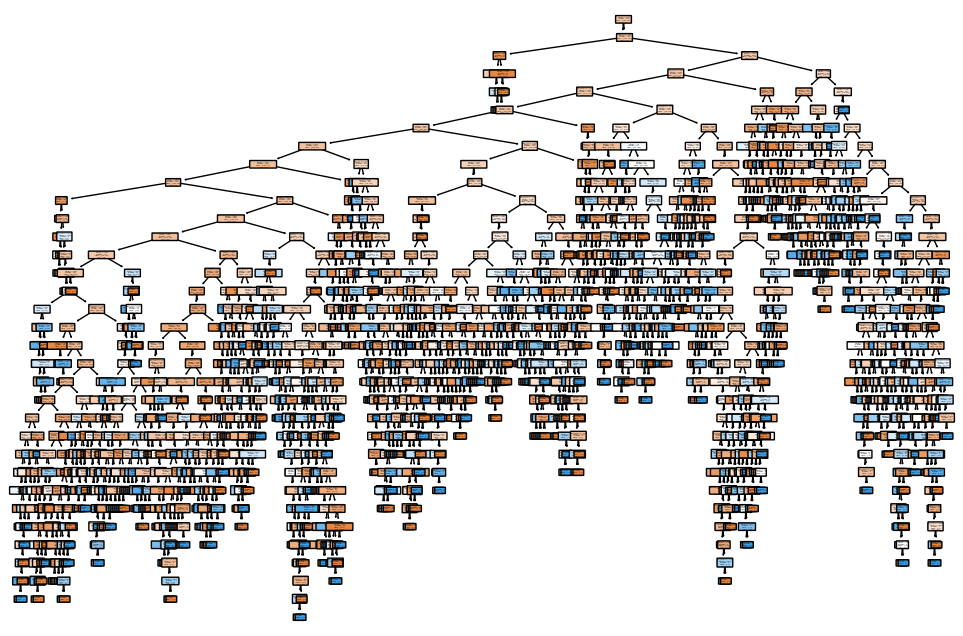

In [61]:
plt.figure(figsize=(12, 8))
plot_tree(dtree, filled=True, feature_names=X.columns, class_names=True, rounded=True)
plt.show()

In [63]:
# scaling data 
from sklearn.preprocessing import MinMaxScaler
scalar = MinMaxScaler()
data.nunique()
# scaling the columns that have nun unique values more than ten 
for col_name in data.columns:
    if data[col_name].nunique()>10: 
        data[col_name] = scalar.fit_transform(data[[col_name]])

In [64]:
# spliting data 
X = data.drop("Heart Attack Risk",axis = 1) 
y = data["Heart Attack Risk"] # target 
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.30, random_state=42)

In [65]:
# decision tree 
dtree = DecisionTreeClassifier(criterion='entropy') # gini or entropy
dtree.fit(X_train, y_train)
pred = dtree.predict(X_test)
after_scaling = accuracy_score(y_test, pred)
print("before : " , before_scaling)
print("after: ", after_scaling)
print("mean_score_error " , mean_squared_error(y_test , pred))

before :  0.5207303157093952
after:  0.5306200076074553
mean_score_error  0.4693799923925447


<BarContainer object of 2 artists>

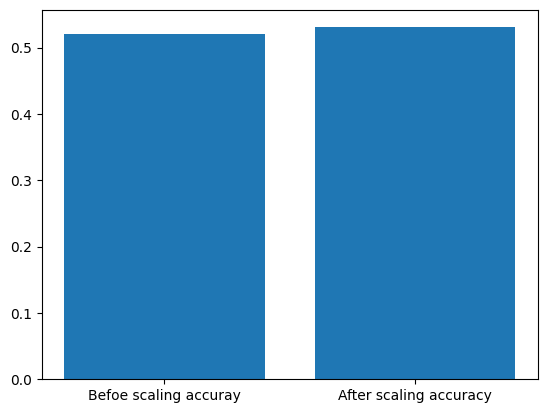

In [66]:
plt.bar(x=['Befoe scaling accuray' , 'After scaling accuracy'] ,
        height=[before_scaling , after_scaling]) 

In [67]:
# ensembles to enhance the algorihm 
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import BaggingClassifier

In [68]:
# Bagging regressor 
bg = BaggingClassifier(dtree , n_estimators=10)
bg.fit(X_train , y_train) 
y_predict = bg.predict(X_test)
print('bagging accuracy : ' , accuracy_score(y_test , y_predict))
print("bagging mean_squared_error " , mean_squared_error(y_test , y_predict))

bagging accuracy :  0.602510460251046
bagging mean_squared_error  0.39748953974895396


In [69]:
rfc = RandomForestClassifier(n_estimators=10)
rfc.fit(X_train , y_train)
y_predict = rfc.predict(X_test)
print('Random accuracy : ' , accuracy_score(y_test , y_predict))
print("Random mean_squared_error " , mean_squared_error(y_test , y_predict))

Random accuracy :  0.5987067325979459
Random mean_squared_error  0.401293267402054


In [71]:
# boosting 
from sklearn.ensemble import GradientBoostingClassifier
gbc = GradientBoostingClassifier(n_estimators=10)
gbc.fit(X_train , y_train)
y_predict = gbc.predict(X_test)
print('Random accuracy : ' , accuracy_score(y_test , y_predict))
print("Random mean_squared_error " , mean_squared_error(y_test , y_predict))

Random accuracy :  0.6432103461392165
Random mean_squared_error  0.3567896538607836


In [72]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import confusion_matrix
model = KNeighborsClassifier(n_neighbors=3)
model.fit(X_train, y_train)
pred = model.predict(X_test)
matrix = confusion_matrix(y_test, pred)
print("confusion_matrix:\n", matrix)
print("accuracy " , accuracy_score(y_test , pred))

confusion_matrix:
 [[1215  476]
 [ 640  298]]
accuracy  0.5755039939140357


In [73]:
# accuracy score
acc = accuracy_score(y_test, pred)
print("accuracy: ", acc)
# precision
pre = precision_score(y_test, pred)
# recall
rec = recall_score(y_test, pred)
print("recall: ", rec)
# fi-measure
f1 = f1_score(y_test, pred)
print("f1-measure: ", f1)

accuracy:  0.5755039939140357
recall:  0.31769722814498935
f1-measure:  0.3481308411214953
